In [1]:
import pandas as pd
import numpy as np
import h5py
import datetime
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.signal import savgol_filter
from IPython import display
plt.style.use('seaborn')
sns.set()

from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import scale
from sklearn import model_selection
from sklearn import linear_model

In [2]:
def get_calibration_temperature(file, calibration_path):
    with h5py.File(file, 'r') as h5_file:
        cal_temp = h5_file[calibration_path].attrs['ftir_temperature']
        return cal_temp

def get_insertion_temperature(file, insertion_path):
    with h5py.File(file, 'r') as h5_file:
        ins_temp = h5_file[insertion_path].attrs['ftir_temp']
        return ins_temp

def get_visible_white_calibration_curve(file, calibration_path):
    with h5py.File(file, 'r') as h5_file:
        cal = h5_file[calibration_path].attrs['white_spectrum'][:]
        return cal

def get_ftir_white_calibration_curve(file, calibration_path):
    with h5py.File(file, 'r') as h5_file:
        cal = h5_file[calibration_path].attrs['white_spectrum2'][:]
        return cal

def get_visible_wavelength_vector(file, calibration_path):
    with h5py.File(file, 'r') as h5_file:
        waves = h5_file[calibration_path].attrs['spec1_wavelengths_vector'][:]
        return waves

def get_ftir_wavelength_vector(file, calibration_path):
    with h5py.File(file, 'r') as h5_file:
        waves = h5_file[calibration_path].attrs['spec2_wavelengths_vector'][:]
        return waves

def get_ftir_insertion_absorbances(file, insertion_path):
    with h5py.File(file, 'r') as h5_file:
        ins_abs = h5_file[f'{insertion_path}/spectrometer2/derived/absorbances'][:]
        return ins_abs

def get_ftir_insertion_raw_spectra(file, insertion_path):
    with h5py.File(file, 'r') as h5_file:
        ins_raw = h5_file[f'{insertion_path}/spectrometer2/spectra'][:]
        return ins_raw

def get_ftir_insertion_timestamps(file, insertion_path):
    with h5py.File(file, 'r') as h5_file:
        timestamps = h5_file[f'{insertion_path}/spectrometer2/timestamps'][:]
        return timestamps
    
def get_ftir_insertion_spectrum_depths(file, insertion_path):
    with h5py.File(file, 'r') as h5_file:
        depths = h5_file[f'{insertion_path}/spectrometer2/spectrum_depths'][:]
        return depths

def get_visible_insertion_timestamps(file, insertion_path):
    with h5py.File(file, 'r') as h5_file:
        timestamps = h5_file[f'{insertion_path}/spectrometer1/timestamps'][:]
        return timestamps

def get_visible_insertion_absorbances(file, insertion_path):
    with h5py.File(file, 'r') as h5_file:
        ins_abs = h5_file[f'{insertion_path}/spectrometer1/derived/absorbances'][:]
        return ins_abs

def get_visible_insertion_raw_spectra(file, insertion_path):
    with h5py.File(file, 'r') as h5_file:
        ins_raw = h5_file[f'{insertion_path}/spectrometer1/spectra'][:]
        return ins_raw
    
def get_visible_insertion_spectrum_depths(file, insertion_path):
    with h5py.File(file, 'r') as h5_file:
        depths = h5_file[f'{insertion_path}/spectrometer1/spectrum_depths'][:]
        return depths   

def create_list_of_items_in_node(item_type, file, node):
    with h5py.File(file, 'r') as h5_file:
        keys = []
        if item_type == "group":
            my_type = h5py._hl.group.Group
        if item_type == "dataset":
            my_type = h5py._hl.dataset.Dataset
        h5_file[node].visit(lambda key: keys.append(key) if type(h5_file[node][key]) is my_type else None)
        return keys

def create_list_of_calibrations_in_node(file, node):
    calibrations = []
    all_groups = create_list_of_items_in_node("group", file, node)
    for group in all_groups:
        if group[-6:-3] == 'cal':
            calibrations.append(node + '/' + group)
    return calibrations

def create_list_of_insertions_in_calibration(file, calibration_path):
    with h5py.File(file, 'r') as h5_file:
        insertion_keys = list(h5_file[calibration_path].keys())
        insertions = [f'{calibration_path}/{key}' for key in insertion_keys]
        return insertions

def select_by_depth_range(df, range_start, range_end):
    df_out = df.loc[(df['depth'] > range_start) & (df['depth'] < range_end)]
    return df_out

def calculate_absorbance_from_raw(raw_spectrum, white_spectrum, dark_spectrum):
    reflectance = ((raw_spectrum - dark_spectrum) / (white_spectrum - dark_spectrum))
    inverse_reflectance = 1/reflectance
    absorbance = np.log10(inverse_reflectance.astype(np.float64))
    return absorbance

def calculate_absorbance_for_2D_array(array, white_spectrum, dark_spectrum):
    absorbance_array = np.empty_like(array, dtype=np.float64)
    for i in range(array.shape[0]):
        absorbance_spectrum = calculate_absorbance_from_raw(array[i, :], white_spectrum, dark_spectrum)
        absorbance_array[i, :] = absorbance_spectrum
    return absorbance_array

def construct_full_file_path(data_path, file_name):
    file_path = data_path + file_name
    return file_path

def create_list_of_sessions_in_file(file_name):
    sessions = []
    all_groups = create_list_of_items_in_node("group", file_name, "/")
    for group in all_groups:
        if (group[0:3] == 'ses') and (len(group) == 10):
            sessions.append(group)
    return sessions

def create_list_of_insertions_in_file(file_name):
    insertions = []
    sessions = create_list_of_sessions_in_file(file_name)
    for session in sessions:
        calibrations = create_list_of_calibrations_in_node(file_name, session)
        for calibration in calibrations:
            cal_insertions = create_list_of_insertions_in_calibration(file_name, calibration)
            for insertion in cal_insertions:
                insertions.append(insertion)
    return insertions

def get_insertion_timestamp(file, insertion_path):
    with h5py.File(file, 'r') as h5_file:
        ins_time = h5_file[insertion_path].attrs['start_time']
        ins_timestamp = pd.Timestamp(ins_time, unit='us')
        return ins_timestamp

def get_calibration_timestamp(file, calibration_path):
    with h5py.File(file, 'r') as h5_file:
        cal_time = h5_file[calibration_path].attrs['calibration_start_time']
        cal_timestamp = pd.Timestamp(cal_time, unit='us')
        return cal_timestamp

def find_position_in_wavelength_vector(wavelength_vector, integer):
    position = np.where(np.isclose(wavelength_vector, integer, 1e-3))[0][0]
    return position

def normalize(value, max_value, min_value):
    normalized_value = (value - min_value)/(max_value - min_value)
    return normalized_value

def get_ftir_dark_calibration_curve(file, calibration_path):
    with h5py.File(file, 'r') as h5_file:
        cal = h5_file[calibration_path].attrs['dark_spectrum2'][:]
        return cal

def get_visible_dark_calibration_curve(file, calibration_path):
    with h5py.File(file, 'r') as h5_file:
        cal = h5_file[calibration_path].attrs['dark_spectrum'][:]
        return cal

def get_ftir_spectrum_timestamp(file, insertion_path, index):
    with h5py.File(file, 'r') as h5_file:
        time = h5_file[f'{insertion_path}/spectrometer2/timestamps'][index]
        timestamp = pd.Timestamp(time, unit='us')
        return timestamp

def get_visible_spectrum_timestamp(file, insertion_path, index):
    with h5py.File(file, 'r') as h5_file:
        time = h5_file[f'{insertion_path}/spectrometer1/timestamps'][index]
        timestamp = pd.Timestamp(time, unit='us')
        return timestamp

def compute_3D_distance(x1, y1, z1, x2, y2, z2):
    distance = math.sqrt((x1 - x2)**2 + (y1 - y2)**2 + (z1 - z2)**2)
    return distance

def calculate_wavenumbers_from_wavelengths(wavelength_vector):
    return 10000000/wavelength_vector

def put_spectrum_in_wavenum_order(spectrum):
    return np.flip(spectrum)

def normalize_depth(depth, depth_min, depth_max):
    return (depth - depth_min) / (depth_max - depth_min)

def get_spectrometer_name(file, session, spectrometer_number):
    with h5py.File(file, 'r') as h5_file:
        name = h5_file[session].attrs[f'spectrometer{spectrometer_number}'][:]
        return name

# Read and clean BNP data

The following cell reads the Bath absorbance data from 5/27/21 and 6/4/21.  It trims the spectra to eliminate the noisy regions at the extreme wavelengths of the spectrometers.  It also creates a column called "use" that marks rows with clearly bad spectra so they can be filtered out.

In [3]:
path_name = "/Users/linda/OneDrive/Documents/S4_mine_p/Projects/Data_collected/"
green_list_df = pd.read_csv('data/Green_misc_insertions_210604.csv')

ftir_min_index = 113
ftir_max_index = 665
ftir_length = ftir_max_index - ftir_min_index

vis_min_index = 0
vis_max_index = 407
vis_length = vis_max_index - vis_min_index

all_absorbances = []
all_depths = []
df = pd.DataFrame()

dates = ['5/27/21', '6/4/21']

for date in dates: 
    bath_df = green_list_df.loc[green_list_df['date'] == date]
    file_name = bath_df.iat[0, 0]
    file = path_name + file_name
    
    for index in bath_df.index.values:
        session = bath_df['session'][index]
        calibration = bath_df['calibration'][index]
        insertion = bath_df['insertion'][index]
        i_unique = bath_df['i_unique'][index]
        stop = date + " " + bath_df['target'][index][-3:]
        cal_path = f'{session}/{calibration}'
        insertion_path = f'{session}/{calibration}/{insertion}'
        vis_waves = get_visible_wavelength_vector(file, cal_path)[vis_min_index:vis_max_index]
        vis_columns = ["%.1f" % wave for wave in vis_waves]
        insertion_df = pd.DataFrame(get_visible_insertion_absorbances(file, insertion_path)[:, vis_min_index:vis_max_index], columns=vis_columns)

        ftir_waves = get_ftir_wavelength_vector(file, cal_path)[ftir_min_index:ftir_max_index]

        ftir_columns = ["%.1f" % wave for wave in ftir_waves]
        ftir_insertion_df = pd.DataFrame(get_ftir_insertion_absorbances(file, insertion_path)[:, ftir_min_index:ftir_max_index], columns=ftir_columns)

        insertion_df = pd.concat([insertion_df, ftir_insertion_df], axis=1)
        insertion_df['depth'] = get_visible_insertion_spectrum_depths(file, insertion_path)
        insertion_df['session'] = session
        insertion_df['calibration'] = calibration
        insertion_df['insertion'] = insertion
        insertion_df['i_unique'] = i_unique
        insertion_df['stop'] = stop
        insertion_df['use'] = True
        df = pd.concat([df, insertion_df], ignore_index=True)

# to eliminate samples from above the surface
df.loc[(df.depth < 5.0),'use'] = False

# to eliminate the worst motion-affected spectra
df.loc[(df['1203.8'] > 0.8), 'use'] = False
# df.loc[(df['1203.8'] < 0.20), 'use'] = False
# df.loc[(df['1400.3'] > 0.65), 'use'] = False

# to eliminate vegetation spectra
df.loc[(df['671.2']/df['735.7'] > 1.3), 'use'] = False

#df.loc[(df['1951.1'] < df['2002.5']), 'use'] = False
    
print(df.shape)


(1125, 966)


In [4]:
# This is to figure out how many spectra remain good to use in the dataset
# based on the criteria used to mark them.
df.loc[df['use']].shape

(972, 966)

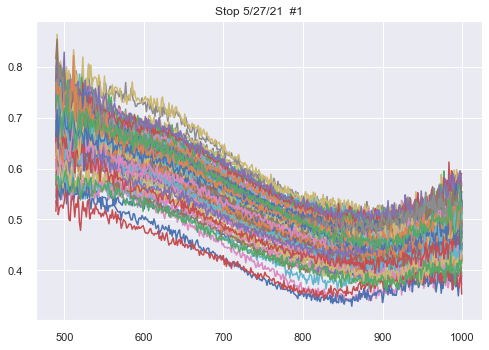

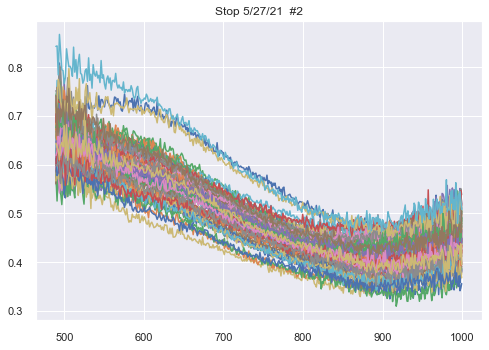

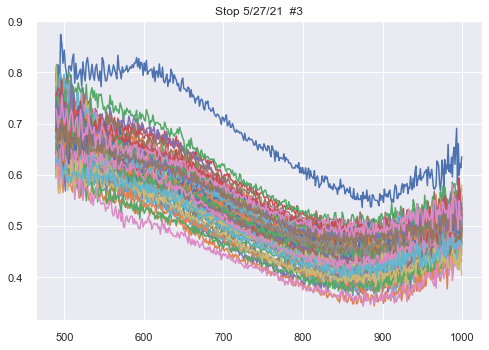

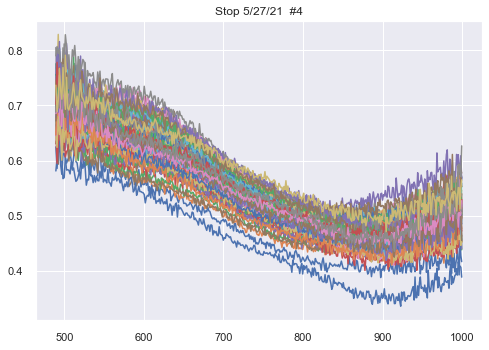

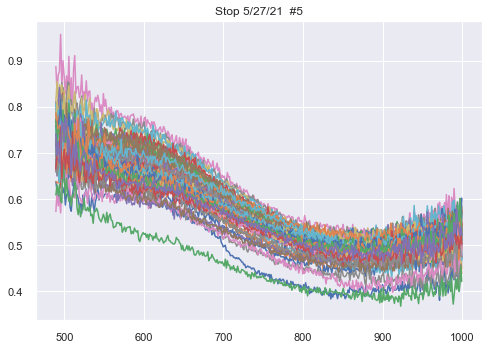

...

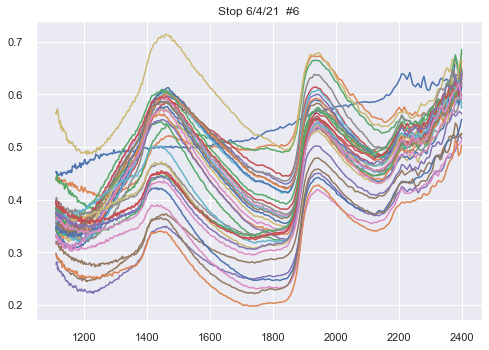

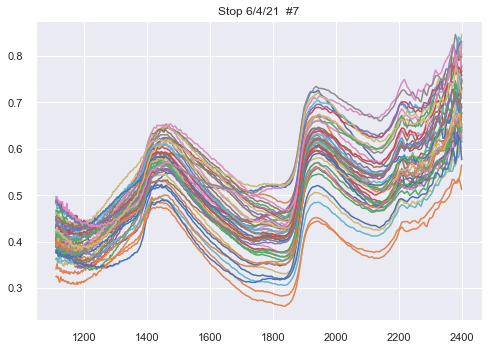

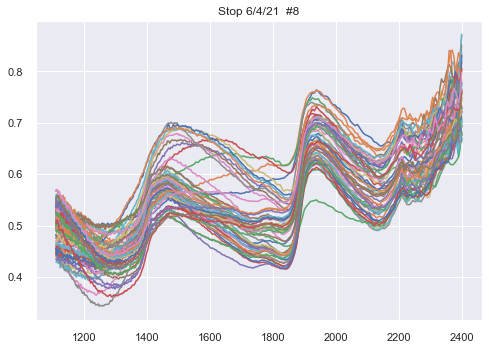

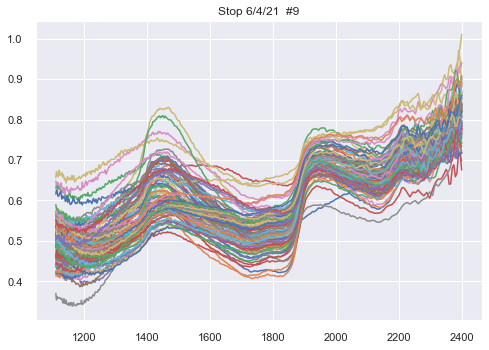

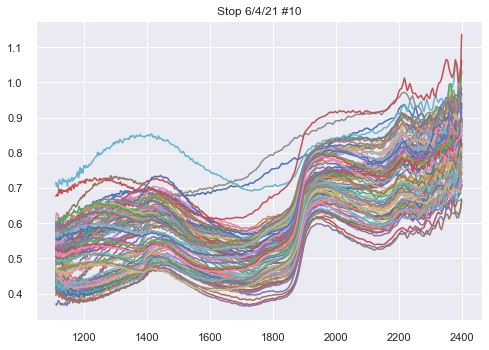

In [5]:
# creates a dataframe containing only the "use" rows
df_use = df.loc[df['use']].copy()

# plots the visible data by stop
for stop in df_use['stop'].unique():
    stop_df = df_use.loc[df_use['stop'] == stop]
    
    
    fig, ax = plt.subplots()
    ax.set_title(f"Stop {stop}")
    for i in range(stop_df.shape[0]):
        ax.plot(vis_waves, stop_df.iloc[i, :vis_max_index])
    plt.show()
    plt.close()
    
# plots the ftir data by stop    
for stop in df_use['stop'].unique():
    stop_df = df_use.loc[df_use['stop'] == stop]
    
    
    fig, ax = plt.subplots()
    ax.set_title(f"Stop {stop}")
    for i in range(stop_df.shape[0]):
        ax.plot(ftir_waves, stop_df.iloc[i, vis_max_index:(ftir_length + vis_max_index)])
    plt.show()
    plt.close()
    
        

In [6]:
stops = df_use['stop'].unique()
grouped = df_use.groupby('stop').mean()

In [7]:
grouped

,489.3,490.8,492.3,493.8,495.3,496.8,498.3,499.8,501.3,502.7,...,2363.4,2368.3,2373.3,2378.2,2383.2,2388.2,2393.2,2398.2,depth,use
stop,,,,,,,,,,,,,,,,,,,,,
5/27/21 #1,0.683030,0.711719,0.684245,0.688920,0.699466,0.687065,0.687561,0.692402,0.680105,0.679649,...,0.606383,0.612747,0.613858,0.616100,0.623729,0.631940,0.630172,0.629025,34.820417,True
5/27/21 #2,0.650361,0.659844,0.649490,0.676873,0.660072,0.648409,0.651419,0.645076,0.636484,0.652935,...,0.593951,0.599329,0.598858,0.598916,0.607299,0.616499,0.617393,0.620521,29.800495,True
5/27/21 #3,0.706643,0.715537,0.699337,0.699735,0.703447,0.702366,0.685049,0.699457,0.687078,0.693007,...,0.627194,0.633776,0.635036,0.636998,0.640370,0.645008,0.649763,0.655729,32.479708,True
5/27/21 #4,0.701047,0.703563,0.711762,0.712921,0.701094,0.690448,0.705439,0.705386,0.694128,0.704216,...,0.644625,0.652277,0.652303,0.652851,0.656324,0.660232,0.657699,0.657106,35.714371,True
5/27/21 #5,0.728947,0.723959,0.726711,0.729612,0.734343,0.732200,0.736753,0.733165,0.713736,0.724618,...,0.628475,0.628851,0.633103,0.638099,0.636510,0.636170,0.643300,0.651001,30.709174,True
5/27/21 #6,0.763171,0.766715,0.791693,0.789344,0.778973,0.784900,0.769924,0.778597,0.779839,0.775340,...,0.616882,0.623369,0.629095,0.635752,0.635872,0.636714,0.637654,0.639583,38.141495,True
6/4/21 #1,0.711548,0.726233,0.712497,0.717934,0.719436,0.716722,0.711338,0.725773,0.710867,0.711278,...,0.550745,0.553279,0.554022,0.554818,0.559124,0.564294,0.568693,0.575427,23.866893,True
6/4/21 #2,0.768547,0.749710,0.748400,0.770806,0.745777,0.760248,0.759908,0.740760,0.732015,0.747866,...,0.681242,0.683226,0.685196,0.687534,0.690462,0.694155,0.697832,0.702282,20.365768,True
6/4/21 #3,0.871084,0.875713,0.860423,0.873566,0.861177,0.870140,0.838087,0.842820,0.862762,0.850157,...,0.676859,0.680112,0.684830,0.691122,0.697337,0.704319,0.708856,0.713653,38.492925,True


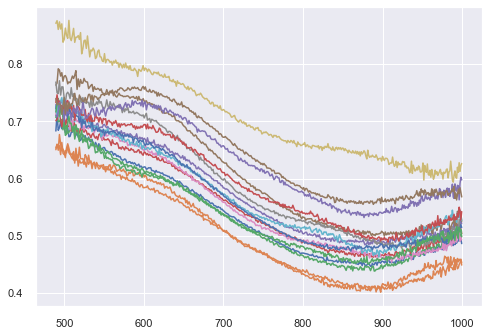

In [8]:
fig, ax = plt.subplots()

for i in range(grouped.shape[0]):
    ax.plot(vis_waves, grouped.iloc[i, :vis_max_index])
plt.show()
plt.close()


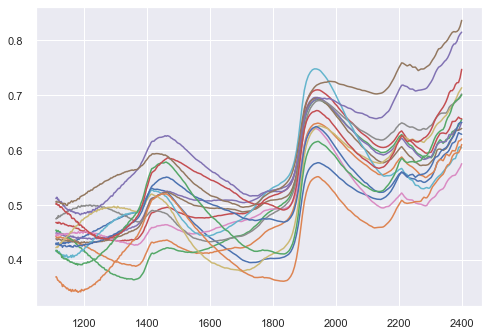

In [9]:
fig, ax = plt.subplots()

for i in range(grouped.shape[0]):
    ax.plot(ftir_waves, grouped.iloc[i, vis_max_index:(ftir_length + vis_max_index)])
plt.show()
plt.close()

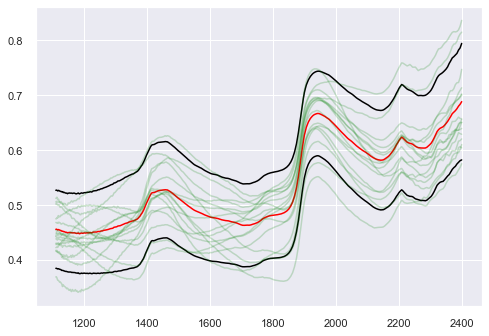

In [10]:
mean = df_use.iloc[:, vis_max_index:(ftir_length + vis_max_index)].mean()
sd = df_use.iloc[:, vis_max_index:(ftir_length + vis_max_index)].std()
fig, ax = plt.subplots()
ax.plot(ftir_waves, mean, color="red")
ax.plot(ftir_waves, mean - sd, color="black")
ax.plot(ftir_waves, mean + sd, color="black")

for i in range(grouped.shape[0]):
    ax.plot(ftir_waves, grouped.iloc[i, vis_max_index:(ftir_length + vis_max_index)], color='green', alpha=0.2)
plt.show()
plt.close()

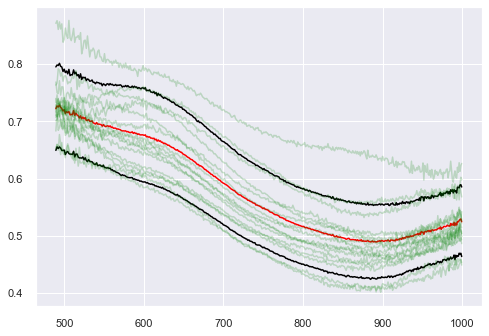

In [11]:
mean = df_use.iloc[:, :vis_max_index].mean()
sd = df_use.iloc[:, :vis_max_index].std()
fig, ax = plt.subplots()
ax.plot(vis_waves, mean, color="red")
ax.plot(vis_waves, mean - sd, color="black")
ax.plot(vis_waves, mean + sd, color="black")

for i in range(grouped.shape[0]):
    ax.plot(vis_waves, grouped.iloc[i, :vis_max_index], color='green', alpha=0.2)
plt.show()
plt.close()

In [12]:
print(vis_columns)

['489.3', '490.8', '492.3', '493.8', '495.3', '496.8', '498.3', '499.8', '501.3', '502.7', '504.2', '505.7', '507.2', '508.6', '510.1', '511.6', '513.0', '514.5', '516.0', '517.4', '518.9', '520.3', '521.8', '523.2', '524.7', '526.1', '527.6', '529.0', '530.5', '531.9', '533.4', '534.8', '536.2', '537.7', '539.1', '540.5', '541.9', '543.4', '544.8', '546.2', '547.6', '549.0', '550.5', '551.9', '553.3', '554.7', '556.1', '557.5', '558.9', '560.3', '561.7', '563.1', '564.5', '565.9', '567.3', '568.7', '570.1', '571.5', '572.9', '574.3', '575.7', '577.0', '578.4', '579.8', '581.2', '582.6', '584.0', '585.3', '586.7', '588.1', '589.5', '590.8', '592.2', '593.6', '594.9', '596.3', '597.7', '599.0', '600.4', '601.8', '603.1', '604.5', '605.8', '607.2', '608.6', '609.9', '611.3', '612.6', '614.0', '615.3', '616.7', '618.0', '619.4', '620.7', '622.1', '623.4', '624.7', '626.1', '627.4', '628.8', '630.1', '631.5', '632.8', '634.1', '635.5', '636.8', '638.1', '639.5', '640.8', '642.1', '643.5', 

In [13]:
print(ftir_columns)

['1111.2', '1112.3', '1113.3', '1114.4', '1115.5', '1116.6', '1117.7', '1118.8', '1119.9', '1121.0', '1122.1', '1123.2', '1124.3', '1125.4', '1126.5', '1127.6', '1128.8', '1129.9', '1131.0', '1132.1', '1133.2', '1134.4', '1135.5', '1136.6', '1137.8', '1138.9', '1140.0', '1141.2', '1142.3', '1143.5', '1144.6', '1145.8', '1146.9', '1148.1', '1149.2', '1150.4', '1151.5', '1152.7', '1153.9', '1155.0', '1156.2', '1157.4', '1158.6', '1159.7', '1160.9', '1162.1', '1163.3', '1164.5', '1165.7', '1166.9', '1168.1', '1169.3', '1170.5', '1171.7', '1172.9', '1174.1', '1175.3', '1176.5', '1177.7', '1178.9', '1180.1', '1181.4', '1182.6', '1183.8', '1185.0', '1186.3', '1187.5', '1188.7', '1190.0', '1191.2', '1192.5', '1193.7', '1195.0', '1196.2', '1197.5', '1198.7', '1200.0', '1201.3', '1202.5', '1203.8', '1205.1', '1206.3', '1207.6', '1208.9', '1210.2', '1211.5', '1212.8', '1214.0', '1215.3', '1216.6', '1217.9', '1219.2', '1220.5', '1221.8', '1223.2', '1224.5', '1225.8', '1227.1', '1228.4', '1229.7',

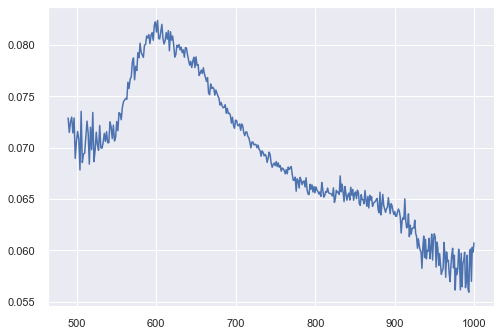

In [14]:
fig, ax = plt.subplots()
ax.plot(vis_waves, df_use.iloc[:, :vis_max_index].std())
plt.show()
plt.close()

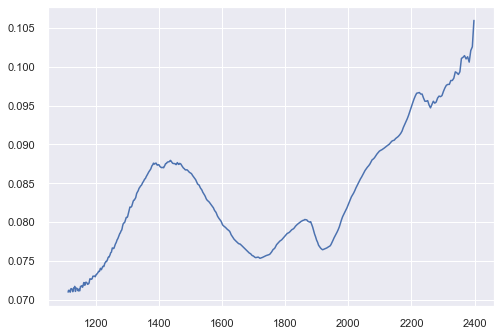

In [15]:
fig, ax = plt.subplots()
ax.plot(ftir_waves, df_use.iloc[:, vis_max_index:(ftir_length + vis_max_index)].std())
plt.show()
plt.close()

In [16]:
all_waves = np.append([vis_waves], [ftir_waves])

In [17]:
print(vis_waves.shape[0])
print(ftir_waves.shape[0])
print(all_waves.shape[0])
print(df_use.shape)

407
552
959
(972, 966)


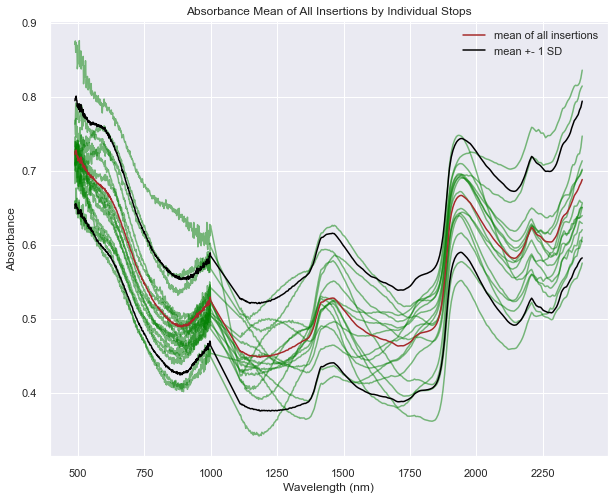

In [71]:
mean = df_use.iloc[:, :(vis_length + ftir_length)].mean()
sd = df_use.iloc[:, :(vis_length + ftir_length)].std()
fig, ax = plt.subplots(figsize=(10, 8))
ax.set_title('Absorbance Mean of All Insertions by Individual Stops')
ax.set_ylabel("Absorbance")
ax.set_xlabel("Wavelength (nm)")


for i in range(grouped.shape[0]):
    ax.plot(all_waves, grouped.iloc[i, :(vis_length + ftir_length)], color='green', alpha=0.5)
    
ax.plot(all_waves, mean, color="brown", label='mean of all insertions')
ax.plot(all_waves, mean - sd, color="black", label='mean +- 1 SD')
ax.plot(all_waves, mean + sd, color="black")
ax.legend()    
plt.show()
plt.close()

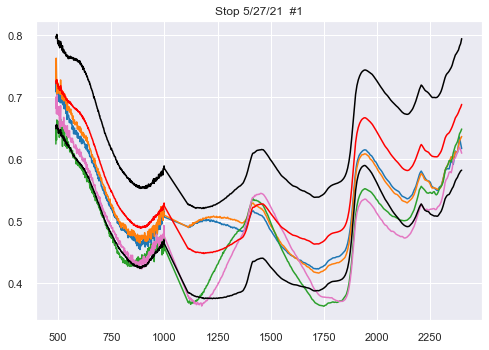

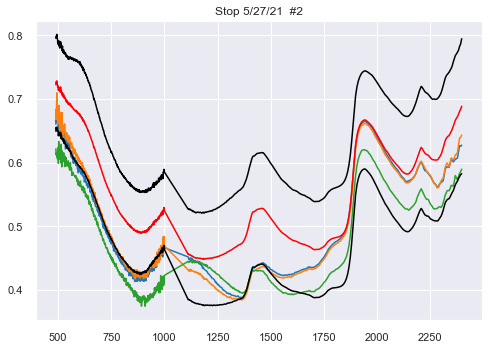

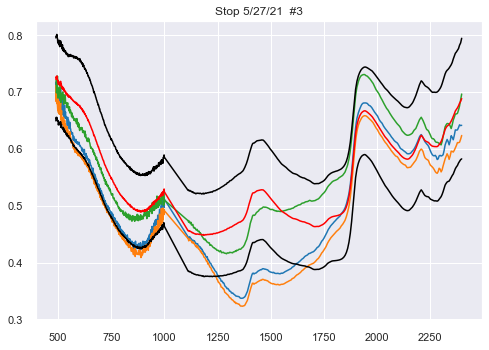

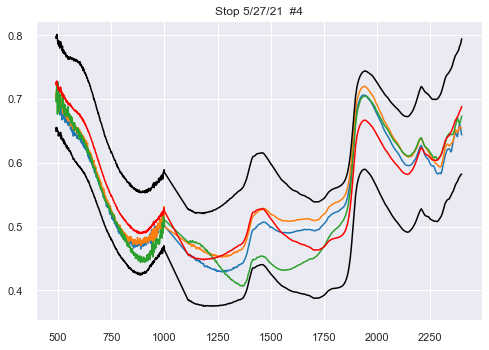

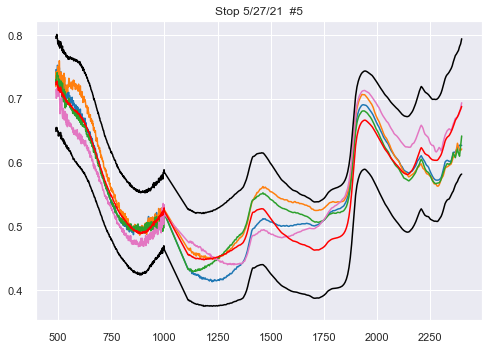

...

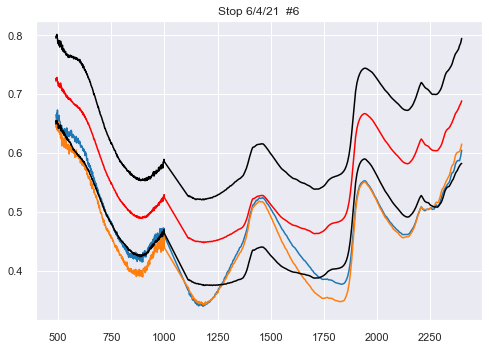

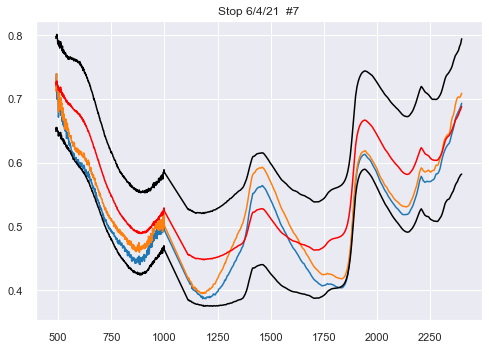

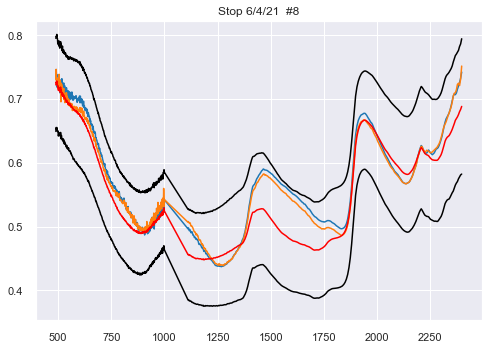

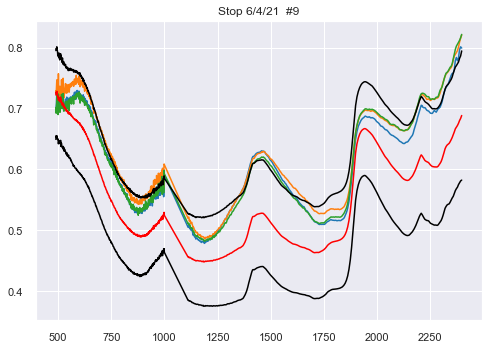

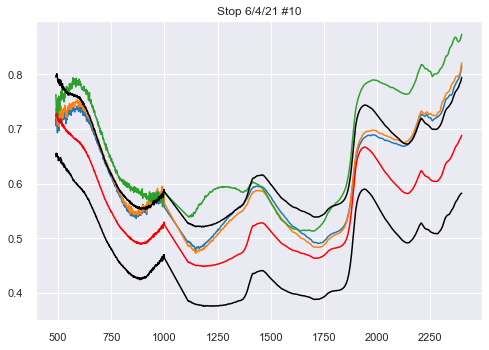

In [19]:
colors = ['tab:blue', 'tab:orange', 'tab:green', 'tab:pink', 'tab:cyan']
df_use = df.loc[df['use']].copy()

mean = df_use.iloc[:, :(vis_length + ftir_length)].mean()
sd = df_use.iloc[:, :(vis_length + ftir_length)].std()


for stop in df_use['stop'].unique():
    stop_df = df_use.loc[df_use['stop'] == stop]
    stop_grouped = stop_df.groupby('i_unique').mean()
    
    fig, ax = plt.subplots()
    ax.set_title(f"Stop {stop}") 
    
    # for i in range(stop_df.shape[0]):
        # index = stop_df['i_unique'].unique().tolist().index(stop_df.iat[i, -3])
        # ax.plot(all_waves, stop_df.iloc[i, :(vis_length + ftir_length)], 
                # color=colors[index], alpha=0.2)
        
    for i in range(stop_grouped.shape[0]):
        ax.plot(all_waves, stop_grouped.iloc[i, :(vis_length + ftir_length)],
               color=colors[i])
        
    ax.plot(all_waves, mean, color="red")
    ax.plot(all_waves, mean - sd, color="black")
    ax.plot(all_waves, mean + sd, color="black")
    
    plt.show()
    plt.close()   


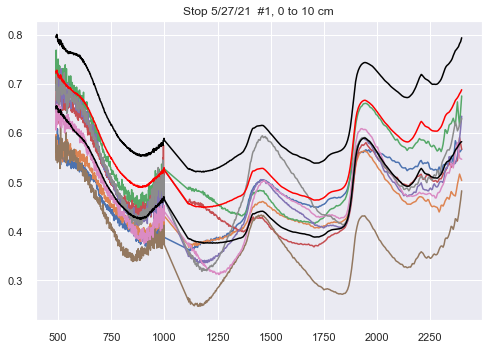

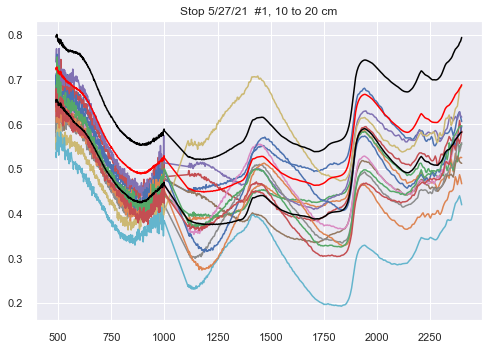

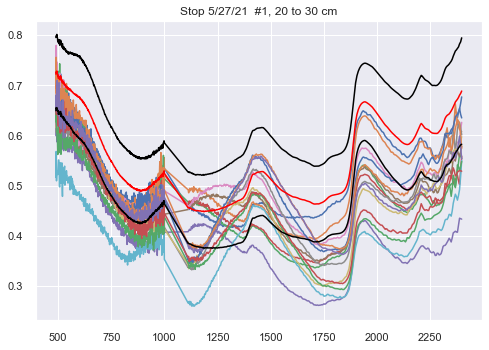

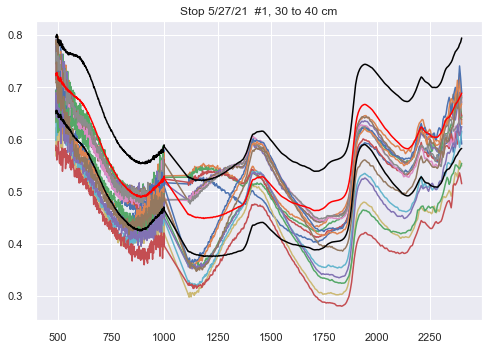

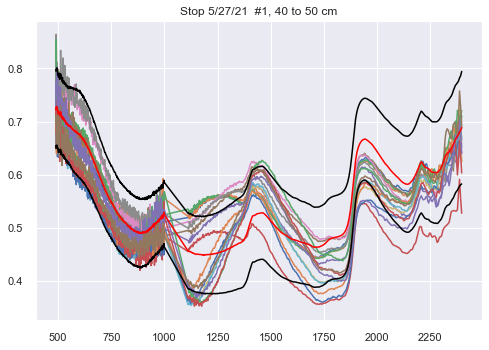

...

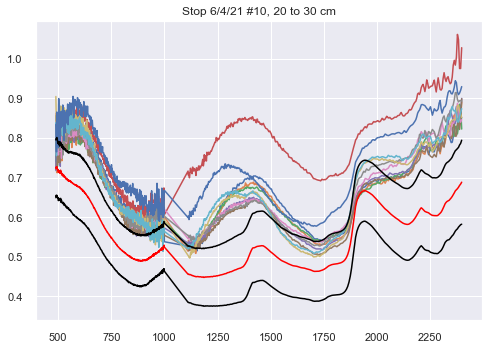

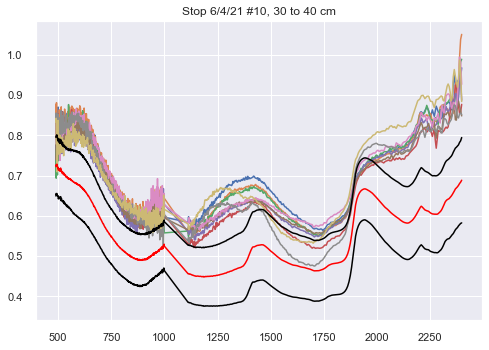

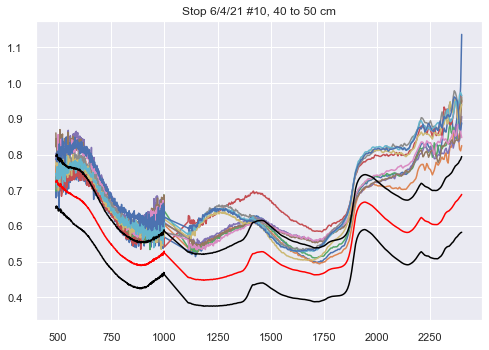

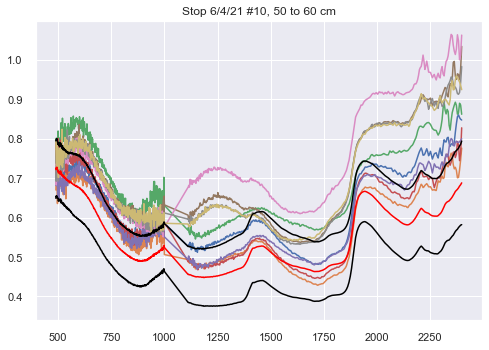

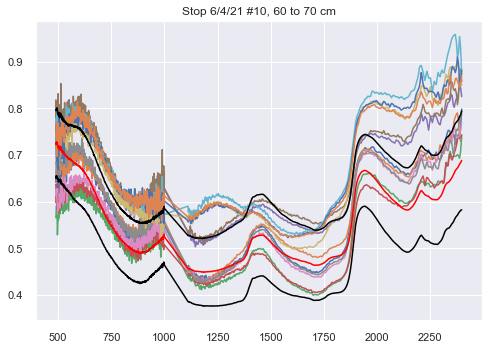

In [20]:
df_use = df.loc[df['use']].copy()
for stop in df_use['stop'].unique():
    stop_df = df_use.loc[df_use['stop'] == stop]
    for depth in range(0, 61, 10):
        depth_min = depth
        depth_max = depth + 10
        depth_df = stop_df.loc[(stop_df['depth'] >= depth_min) & (stop_df['depth'] < depth_max)]       
        


        fig, ax = plt.subplots()
        ax.set_title(f"Stop {stop}, {depth_min} to {depth_max} cm")
        for i in range(depth_df.shape[0]):
            ax.plot(all_waves, depth_df.iloc[i, :(vis_length + ftir_length)])
            
        ax.plot(all_waves, mean, color="red")
        ax.plot(all_waves, mean - sd, color="black")
        ax.plot(all_waves, mean + sd, color="black")
        
        plt.show()
        plt.close()

In [21]:
df_use

,489.3,490.8,492.3,493.8,495.3,496.8,498.3,499.8,501.3,502.7,...,2388.2,2393.2,2398.2,depth,session,calibration,insertion,i_unique,stop,use
2,0.592755,0.595004,0.556869,0.562638,0.575451,0.608713,0.568316,0.595791,0.553331,0.579890,...,0.560884,0.563372,0.566935,5.090261,session001,cal001,ins001,c033i01,5/27/21 #1,True
3,0.549460,0.597024,0.562252,0.545726,0.584911,0.576422,0.555821,0.544372,0.564033,0.560974,...,0.516261,0.509900,0.503233,7.590383,session001,cal001,ins001,c033i01,5/27/21 #1,True
4,0.652600,0.697181,0.714582,0.692694,0.696516,0.723935,0.694603,0.715958,0.679387,0.688890,...,0.627974,0.615990,0.606001,10.090250,session001,cal001,ins001,c033i01,5/27/21 #1,True
5,0.674264,0.695061,0.684457,0.651034,0.658717,0.734895,0.650910,0.649689,0.650682,0.645351,...,0.523754,0.525899,0.525289,12.589967,session001,cal001,ins001,c033i01,5/27/21 #1,True
7,0.659572,0.691270,0.641232,0.650670,0.638009,0.648470,0.677970,0.693227,0.653669,0.667081,...,0.550141,0.554768,0.555111,17.589703,session001,cal001,ins001,c033i01,5/27/21 #1,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1117,0.668106,0.676221,0.675161,0.669482,0.650691,0.669300,0.641118,0.666727,0.666227,0.639645,...,0.426259,0.433309,0.443468,43.464886,session006,cal010,ins018,c077i01,6/4/21 #1,True
1120,0.771529,0.772964,0.782547,0.787362,0.781948,0.791264,0.752377,0.815907,0.733711,0.729079,...,0.557996,0.573227,0.601672,5.059882,session006,cal010,ins019,c077i02,6/4/21 #1,True
1121,0.694620,0.724589,0.719550,0.693096,0.727070,0.737430,0.766246,0.716512,0.710542,0.721626,...,0.580803,0.605677,0.625117,7.560055,session006,cal010,ins019,c077i02,6/4/21 #1,True
1123,0.770001,0.775985,0.781528,0.736575,0.744012,0.726653,0.769898,0.786044,0.755634,0.720849,...,0.635639,0.644143,0.668226,12.560146,session006,cal010,ins019,c077i02,6/4/21 #1,True


In [22]:
X = df_use.iloc[:, :-7].copy()
X.shape

(972, 959)

In [23]:
pca = PCA(n_components=50)
X_pca = pca.fit_transform(StandardScaler().fit_transform(X))

In [24]:
np.cumsum(pca.explained_variance_ratio_)

array([0.65158992, 0.77643388, 0.85506597, 0.91756784, 0.94722593,
       0.96296223, 0.97350887, 0.98011816, 0.9833881 , 0.9862594 ,
       0.98730058, 0.98778441, 0.9881283 , 0.9884173 , 0.98869283,
       0.9889166 , 0.98912124, 0.98930504, 0.98947861, 0.98964863,
       0.98981338, 0.98997156, 0.99012465, 0.99027462, 0.99042171,
       0.99056444, 0.990703  , 0.99083671, 0.99096986, 0.99109966,
       0.991224  , 0.99134737, 0.99146814, 0.99158621, 0.99170343,
       0.99181724, 0.99192721, 0.9920363 , 0.99214462, 0.99224952,
       0.99235334, 0.99245482, 0.99255487, 0.9926531 , 0.99274912,
       0.99284393, 0.9929376 , 0.99302805, 0.99311727, 0.9932047 ])

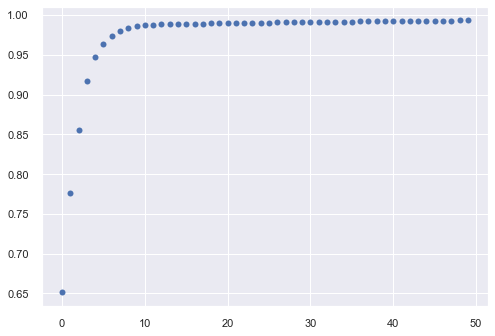

In [25]:
fig, ax = plt.subplots()
ax.plot(np.cumsum(pca.explained_variance_ratio_), 'bo')
plt.show()
plt.close()

In [26]:
X_pca_df = pd.DataFrame(X_pca)

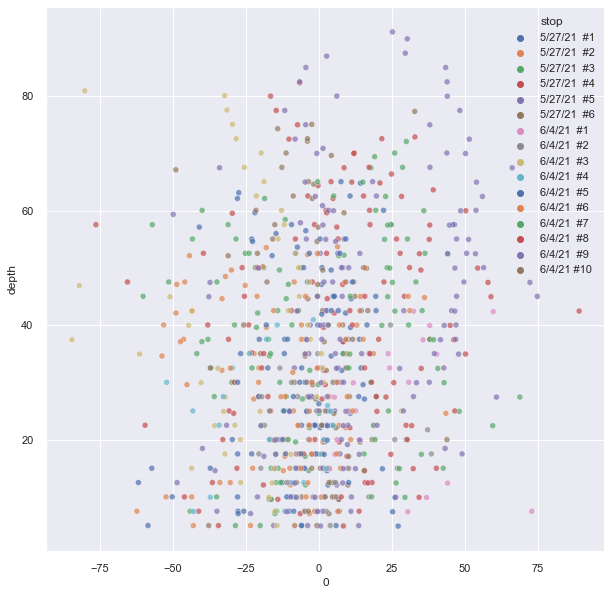

In [62]:
fig, ax = plt.subplots(figsize=(10,10))
sns.scatterplot(x=X_pca_df[0], y=df_use['depth'], hue=df_use['stop'], alpha=0.7, palette='deep')
plt.show()
plt.close()

In [28]:
pca

PCA(n_components=50)

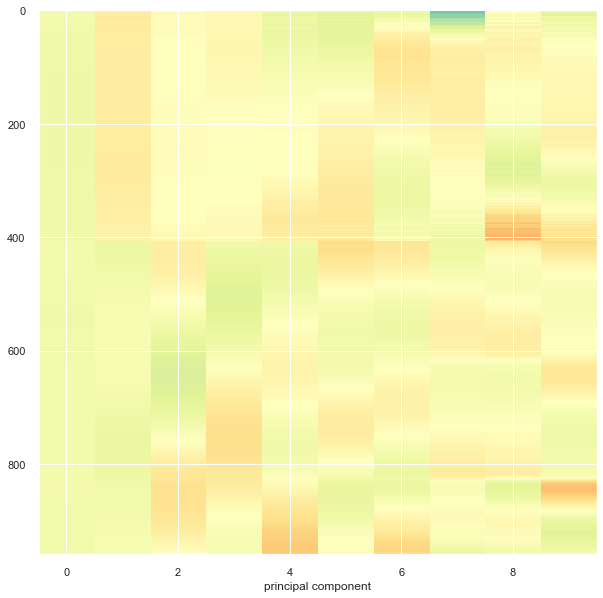

In [29]:
fig, ax = plt.subplots(figsize=(10, 10))
plt.imshow(pca.components_[:10].T, cmap="Spectral", vmin=-0.3, vmax=0.3, aspect='auto',
          interpolation='none')
# plt.yticks(range(len(X.columns)), X.columns)
plt.xlabel("principal component")
plt.show()
plt.close()

In [30]:
pca.components_.shape

(50, 959)

In [31]:
X_pca_df

,0,1,2,3,4,5,6,7,8,9,...,40,41,42,43,44,45,46,47,48,49
0,-35.075329,13.924112,5.922060,-2.896136,-2.176923,-0.423283,0.650032,-5.115899,1.880943,2.711142,...,-0.039503,-0.046518,0.096381,0.021130,-0.043989,0.071068,-0.409867,0.053517,0.053947,-0.167139
1,-38.300554,5.603226,5.079107,0.738845,1.957172,-2.102931,1.447040,-6.254059,1.389110,-0.445103,...,-0.134354,0.038694,-0.107154,0.052954,-0.001680,-0.117175,0.084062,0.237542,0.136493,0.003805
2,-5.959572,10.474187,2.922759,-1.625084,4.821960,3.755042,-0.046115,-1.119634,0.491555,-0.070205,...,-0.076730,0.211317,0.053299,0.221146,-0.550845,0.042737,-0.087057,-0.206446,0.232326,-0.084534
3,-27.628996,-0.927136,3.015198,-0.764991,4.588282,0.367952,0.796725,-1.705633,-0.125548,0.254743,...,0.353866,0.334872,-0.207685,-0.018118,-0.062053,0.430078,-0.274009,0.135382,0.556177,-0.306287
4,-27.766113,1.274694,1.545559,-0.344213,3.548252,-0.926824,1.285098,-1.857200,-0.518284,1.320200,...,0.336365,0.097522,0.219048,-0.351770,-0.011080,-0.241483,0.321991,0.287061,0.325871,-0.102615
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
967,-37.654132,-7.579686,8.879680,-0.237060,4.632678,3.540456,9.323199,-4.511122,-3.601637,-1.861413,...,-0.115412,-0.027108,0.306197,-0.258365,0.474156,-0.288565,0.572845,-0.173937,0.015940,-0.295723
968,-3.564391,4.304708,-6.479982,-13.731038,6.335895,7.372660,5.177846,-1.918926,-1.148814,-3.746696,...,0.149304,0.310098,0.078032,0.075119,-0.340512,-0.067107,-0.028130,-0.116694,0.024570,0.222758
969,2.214177,3.324502,-1.029143,-12.802777,5.220123,3.559899,7.074768,-4.536860,-2.487944,-3.789372,...,-0.141979,-0.046692,-0.006464,-0.274960,0.231834,0.315694,-0.006932,0.435938,0.196455,0.125646
970,3.528728,-1.577603,-10.222306,1.444732,2.057231,5.460889,5.625836,-1.853510,-4.150159,-2.930007,...,0.399839,-0.201305,0.497515,0.065353,-0.305722,-0.269756,0.294146,-0.191912,-0.455854,-0.183618


In [32]:
df_info = df_use.iloc[:, -7:].copy().reset_index()
X_w_info = pd.concat([df_info, X_pca_df], axis=1, ignore_index=True)


In [33]:
df_info

,index,depth,session,calibration,insertion,i_unique,stop,use
0,2,5.090261,session001,cal001,ins001,c033i01,5/27/21 #1,True
1,3,7.590383,session001,cal001,ins001,c033i01,5/27/21 #1,True
2,4,10.090250,session001,cal001,ins001,c033i01,5/27/21 #1,True
3,5,12.589967,session001,cal001,ins001,c033i01,5/27/21 #1,True
4,7,17.589703,session001,cal001,ins001,c033i01,5/27/21 #1,True
...,...,...,...,...,...,...,...,...
967,1117,43.464886,session006,cal010,ins018,c077i01,6/4/21 #1,True
968,1120,5.059882,session006,cal010,ins019,c077i02,6/4/21 #1,True
969,1121,7.560055,session006,cal010,ins019,c077i02,6/4/21 #1,True
970,1123,12.560146,session006,cal010,ins019,c077i02,6/4/21 #1,True


In [34]:
X_pca_df

,0,1,2,3,4,5,6,7,8,9,...,40,41,42,43,44,45,46,47,48,49
0,-35.075329,13.924112,5.922060,-2.896136,-2.176923,-0.423283,0.650032,-5.115899,1.880943,2.711142,...,-0.039503,-0.046518,0.096381,0.021130,-0.043989,0.071068,-0.409867,0.053517,0.053947,-0.167139
1,-38.300554,5.603226,5.079107,0.738845,1.957172,-2.102931,1.447040,-6.254059,1.389110,-0.445103,...,-0.134354,0.038694,-0.107154,0.052954,-0.001680,-0.117175,0.084062,0.237542,0.136493,0.003805
2,-5.959572,10.474187,2.922759,-1.625084,4.821960,3.755042,-0.046115,-1.119634,0.491555,-0.070205,...,-0.076730,0.211317,0.053299,0.221146,-0.550845,0.042737,-0.087057,-0.206446,0.232326,-0.084534
3,-27.628996,-0.927136,3.015198,-0.764991,4.588282,0.367952,0.796725,-1.705633,-0.125548,0.254743,...,0.353866,0.334872,-0.207685,-0.018118,-0.062053,0.430078,-0.274009,0.135382,0.556177,-0.306287
4,-27.766113,1.274694,1.545559,-0.344213,3.548252,-0.926824,1.285098,-1.857200,-0.518284,1.320200,...,0.336365,0.097522,0.219048,-0.351770,-0.011080,-0.241483,0.321991,0.287061,0.325871,-0.102615
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
967,-37.654132,-7.579686,8.879680,-0.237060,4.632678,3.540456,9.323199,-4.511122,-3.601637,-1.861413,...,-0.115412,-0.027108,0.306197,-0.258365,0.474156,-0.288565,0.572845,-0.173937,0.015940,-0.295723
968,-3.564391,4.304708,-6.479982,-13.731038,6.335895,7.372660,5.177846,-1.918926,-1.148814,-3.746696,...,0.149304,0.310098,0.078032,0.075119,-0.340512,-0.067107,-0.028130,-0.116694,0.024570,0.222758
969,2.214177,3.324502,-1.029143,-12.802777,5.220123,3.559899,7.074768,-4.536860,-2.487944,-3.789372,...,-0.141979,-0.046692,-0.006464,-0.274960,0.231834,0.315694,-0.006932,0.435938,0.196455,0.125646
970,3.528728,-1.577603,-10.222306,1.444732,2.057231,5.460889,5.625836,-1.853510,-4.150159,-2.930007,...,0.399839,-0.201305,0.497515,0.065353,-0.305722,-0.269756,0.294146,-0.191912,-0.455854,-0.183618


In [35]:
X_w_info.shape

(972, 58)

In [36]:
X_w_info

,0,1,2,3,4,5,6,7,8,9,...,48,49,50,51,52,53,54,55,56,57
0,2,5.090261,session001,cal001,ins001,c033i01,5/27/21 #1,True,-35.075329,13.924112,...,-0.039503,-0.046518,0.096381,0.021130,-0.043989,0.071068,-0.409867,0.053517,0.053947,-0.167139
1,3,7.590383,session001,cal001,ins001,c033i01,5/27/21 #1,True,-38.300554,5.603226,...,-0.134354,0.038694,-0.107154,0.052954,-0.001680,-0.117175,0.084062,0.237542,0.136493,0.003805
2,4,10.090250,session001,cal001,ins001,c033i01,5/27/21 #1,True,-5.959572,10.474187,...,-0.076730,0.211317,0.053299,0.221146,-0.550845,0.042737,-0.087057,-0.206446,0.232326,-0.084534
3,5,12.589967,session001,cal001,ins001,c033i01,5/27/21 #1,True,-27.628996,-0.927136,...,0.353866,0.334872,-0.207685,-0.018118,-0.062053,0.430078,-0.274009,0.135382,0.556177,-0.306287
4,7,17.589703,session001,cal001,ins001,c033i01,5/27/21 #1,True,-27.766113,1.274694,...,0.336365,0.097522,0.219048,-0.351770,-0.011080,-0.241483,0.321991,0.287061,0.325871,-0.102615
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
967,1117,43.464886,session006,cal010,ins018,c077i01,6/4/21 #1,True,-37.654132,-7.579686,...,-0.115412,-0.027108,0.306197,-0.258365,0.474156,-0.288565,0.572845,-0.173937,0.015940,-0.295723
968,1120,5.059882,session006,cal010,ins019,c077i02,6/4/21 #1,True,-3.564391,4.304708,...,0.149304,0.310098,0.078032,0.075119,-0.340512,-0.067107,-0.028130,-0.116694,0.024570,0.222758
969,1121,7.560055,session006,cal010,ins019,c077i02,6/4/21 #1,True,2.214177,3.324502,...,-0.141979,-0.046692,-0.006464,-0.274960,0.231834,0.315694,-0.006932,0.435938,0.196455,0.125646
970,1123,12.560146,session006,cal010,ins019,c077i02,6/4/21 #1,True,3.528728,-1.577603,...,0.399839,-0.201305,0.497515,0.065353,-0.305722,-0.269756,0.294146,-0.191912,-0.455854,-0.183618


In [37]:
X_w_info.to_csv('data/X_w_info.csv')

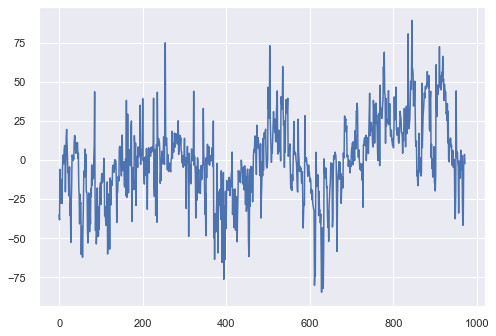

In [38]:
plt.plot(X_pca_df[0])

<AxesSubplot:xlabel='0', ylabel='8'>

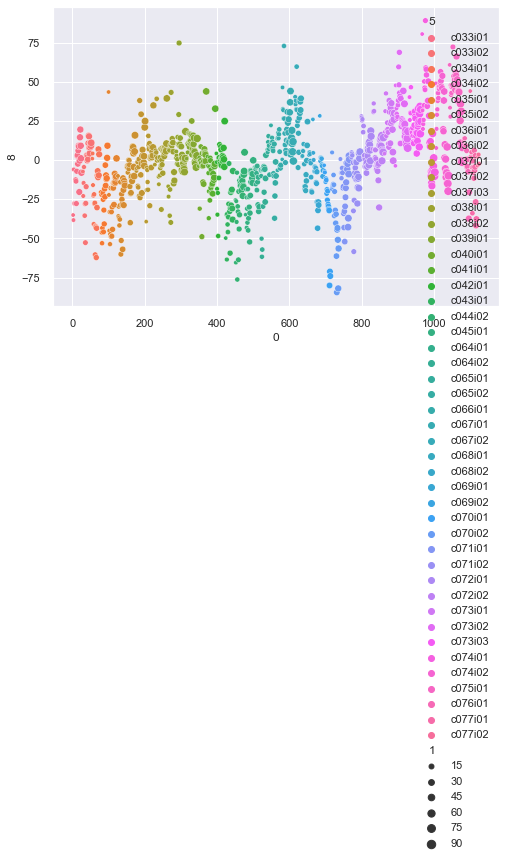

In [39]:
sns.scatterplot(x=X_w_info[0], y=X_w_info[8], size=X_w_info[1], hue=X_w_info[5])

<AxesSubplot:xlabel='0', ylabel='9'>

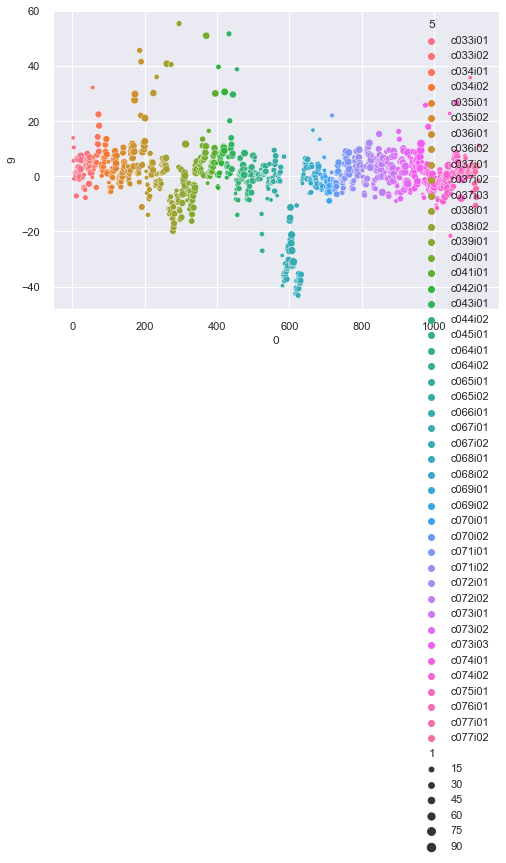

In [40]:
sns.scatterplot(x=X_w_info[0], y=X_w_info[9], size=X_w_info[1], hue=X_w_info[5])

<AxesSubplot:xlabel='0', ylabel='10'>

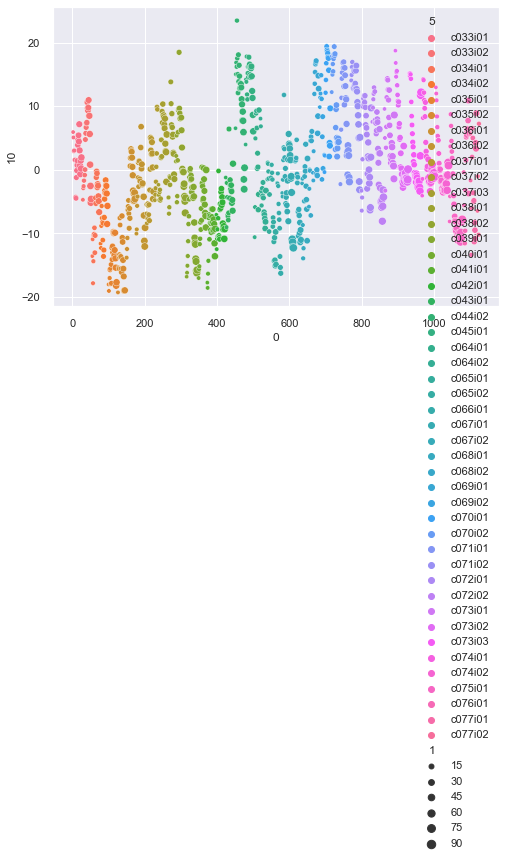

In [41]:
sns.scatterplot(x=X_w_info[0], y=X_w_info[10], size=X_w_info[1], hue=X_w_info[5])

<AxesSubplot:xlabel='0', ylabel='11'>

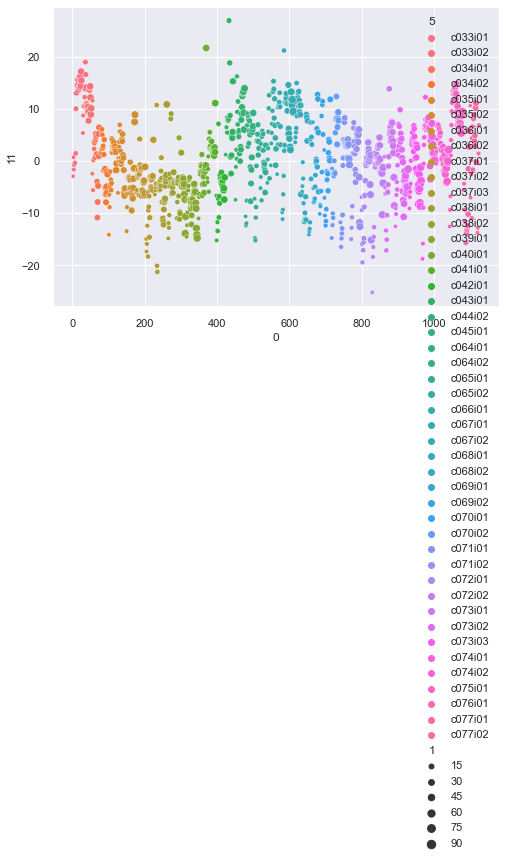

In [42]:
sns.scatterplot(x=X_w_info[0], y=X_w_info[11], size=X_w_info[1], hue=X_w_info[5])

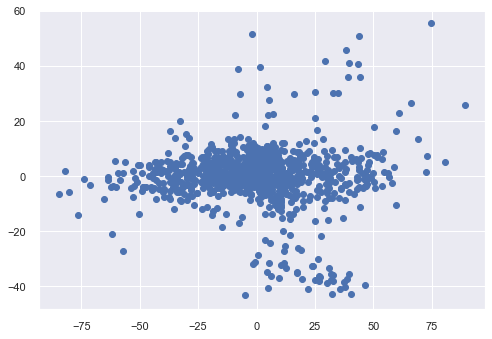

In [43]:
plt.scatter(X_pca[:, 0], X_pca[:, 1])

In [44]:
df_use.iloc[:, :-7].columns

Index(['489.3', '490.8', '492.3', '493.8', '495.3', '496.8', '498.3', '499.8',
       '501.3', '502.7',
       ...
       '2353.7', '2358.5', '2363.4', '2368.3', '2373.3', '2378.2', '2383.2',
       '2388.2', '2393.2', '2398.2'],
      dtype='object', length=959)

In [45]:
X_pca.shape

(972, 50)

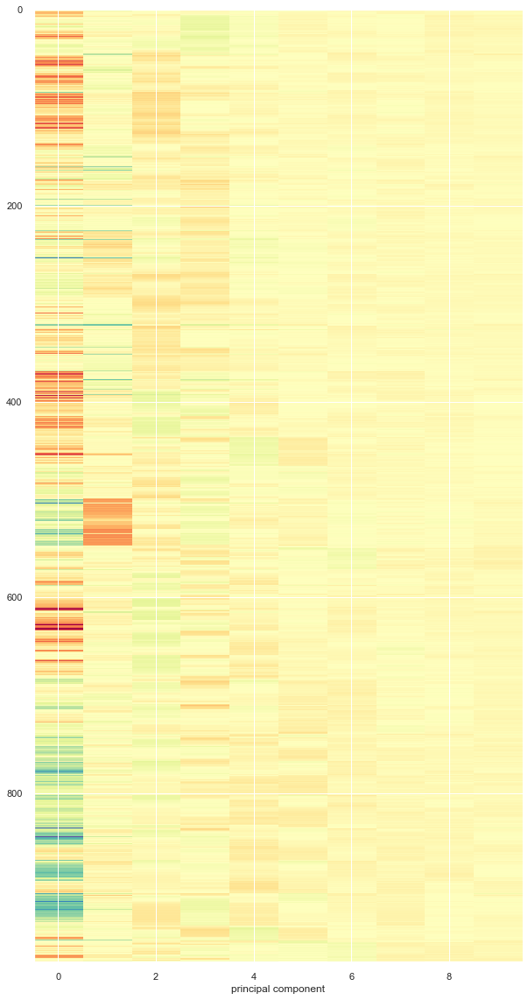

In [46]:
fig, ax = plt.subplots(figsize=(10, 20))
plt.imshow(X_pca[:, :10], cmap="Spectral", aspect='auto',
          interpolation='none')
# plt.yticks(range(len(X.columns)), X.columns)
plt.xlabel("principal component")
plt.show()
plt.close()

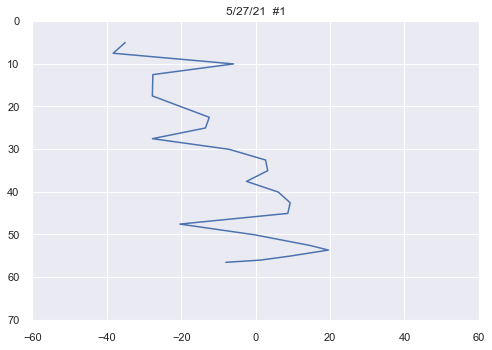

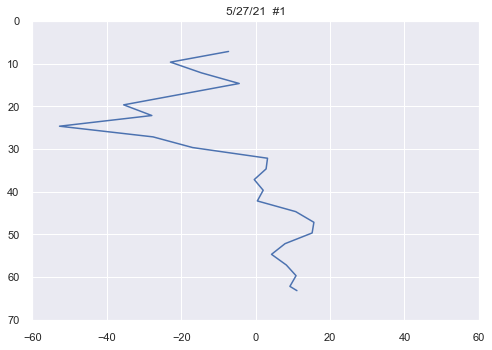

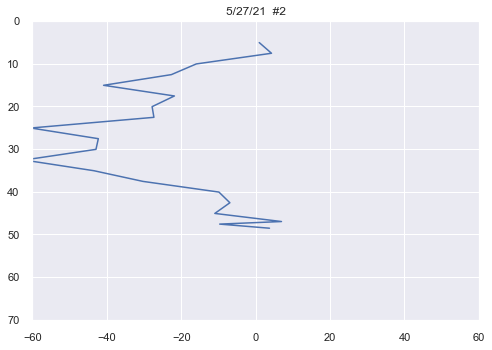

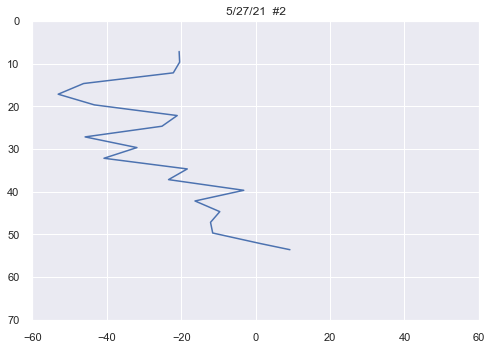

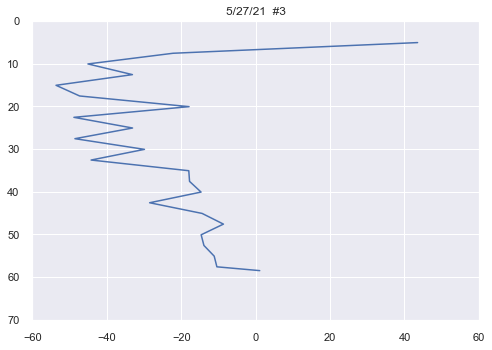

...

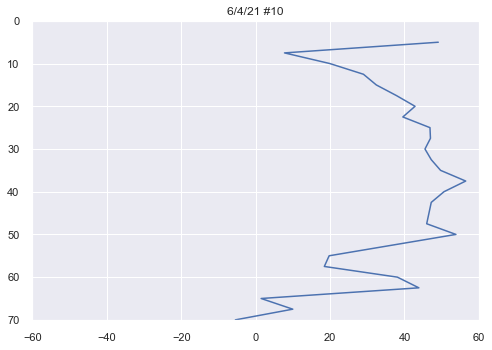

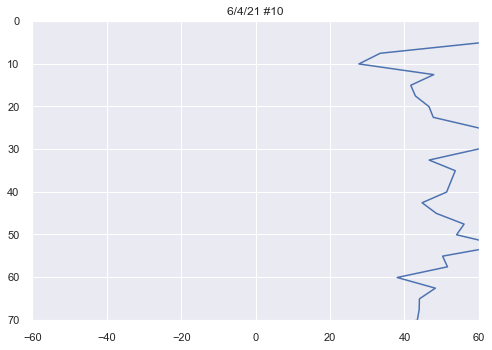

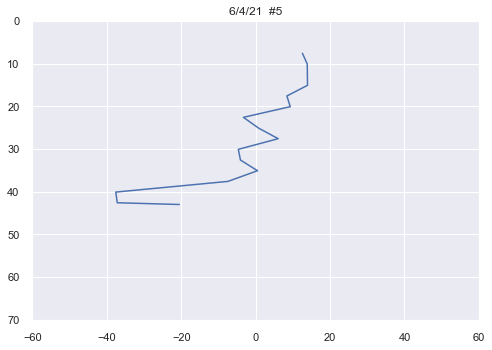

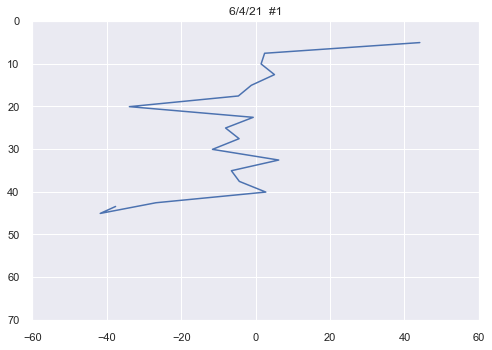

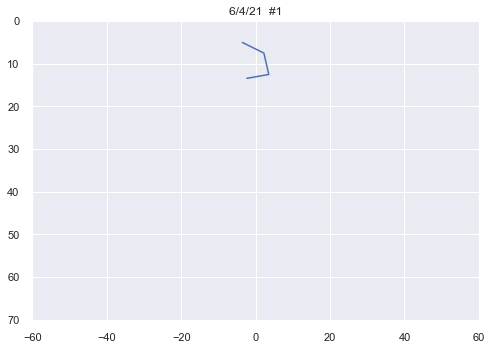

In [47]:
for insertion in df_info['i_unique'].unique():
    insertion_df_info = df_info.loc[df_info['i_unique'] == insertion]
    insertion_components = X_pca_df.loc[df_info['i_unique'] == insertion]
    fig, ax = plt.subplots()
    ax.set_title(insertion_df_info.iat[0, -2])
    ax.set_ylim(70, 0)
    ax.set_xlim(-60, 60)
    ax.plot(insertion_components.iloc[:, 0], insertion_df_info['depth'])
    plt.show()
    plt.close()

In [48]:
X_pca_df.loc[df_info['i_unique'] == insertion]

,0,1,2,3,4,5,6,7,8,9,...,40,41,42,43,44,45,46,47,48,49
968,-3.564391,4.304708,-6.479982,-13.731038,6.335895,7.372660,5.177846,-1.918926,-1.148814,-3.746696,...,0.149304,0.310098,0.078032,0.075119,-0.340512,-0.067107,-0.028130,-0.116694,0.024570,0.222758
969,2.214177,3.324502,-1.029143,-12.802777,5.220123,3.559899,7.074768,-4.536860,-2.487944,-3.789372,...,-0.141979,-0.046692,-0.006464,-0.274960,0.231834,0.315694,-0.006932,0.435938,0.196455,0.125646
970,3.528728,-1.577603,-10.222306,1.444732,2.057231,5.460889,5.625836,-1.853510,-4.150159,-2.930007,...,0.399839,-0.201305,0.497515,0.065353,-0.305722,-0.269756,0.294146,-0.191912,-0.455854,-0.183618
971,-2.368519,11.148054,7.233520,6.860140,7.461247,4.055599,8.492579,-4.226061,-1.607474,-2.739090,...,0.240087,0.354217,0.026065,-0.058224,0.023700,-0.053690,-0.212928,-0.315831,0.064155,0.232742


In [49]:
df_info.loc[df_info['i_unique'] == insertion]

,index,depth,session,calibration,insertion,i_unique,stop,use
968,1120,5.059882,session006,cal010,ins019,c077i02,6/4/21 #1,True
969,1121,7.560055,session006,cal010,ins019,c077i02,6/4/21 #1,True
970,1123,12.560146,session006,cal010,ins019,c077i02,6/4/21 #1,True
971,1124,13.470787,session006,cal010,ins019,c077i02,6/4/21 #1,True


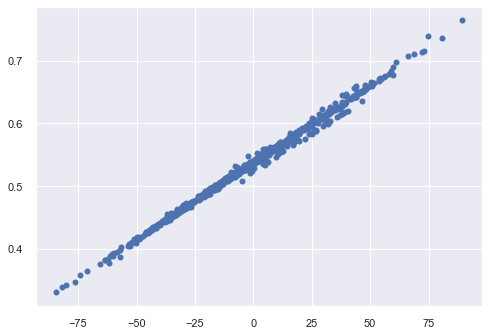

In [50]:
plt.plot(X_pca_df[0], df_use.iloc[:, :-7].mean(axis=1), 'o')

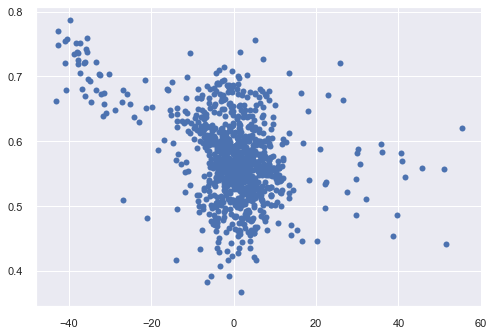

In [51]:
plt.plot(X_pca_df[1], df_use.iloc[:, :vis_max_index].mean(axis=1), 'o')

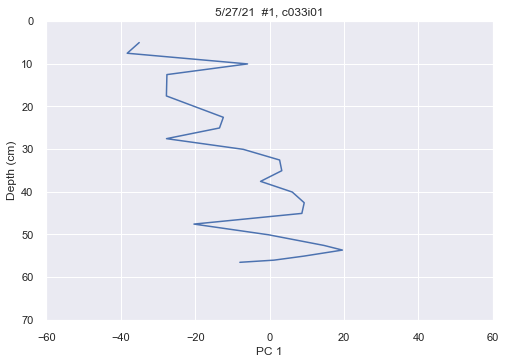

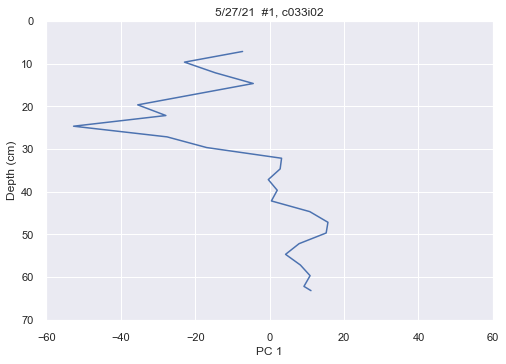

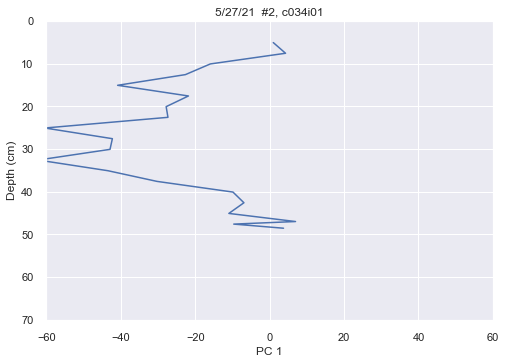

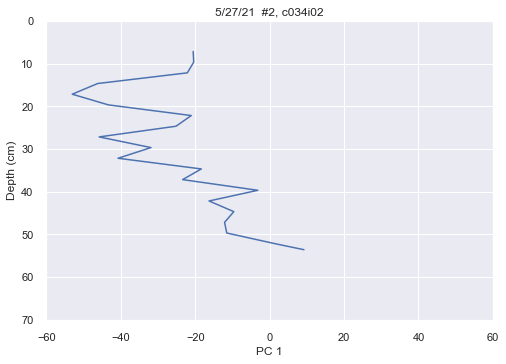

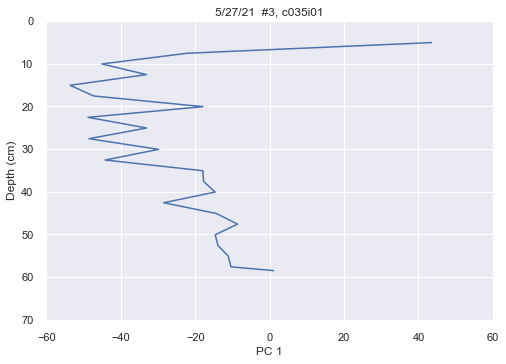

...

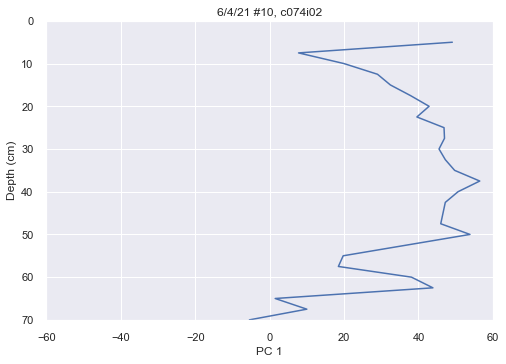

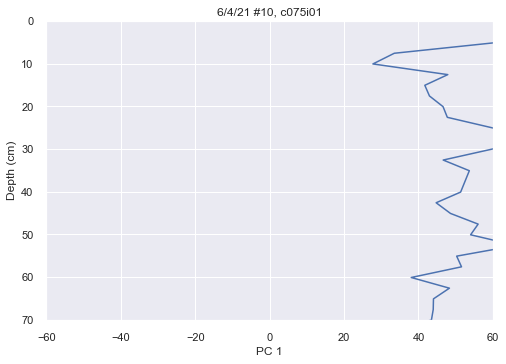

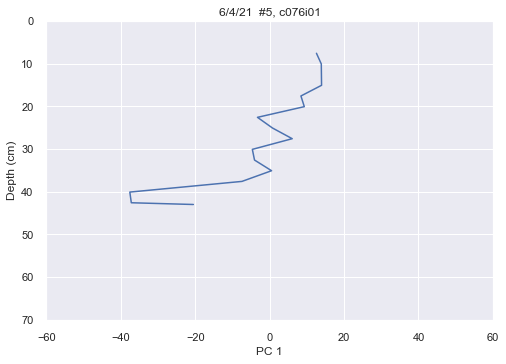

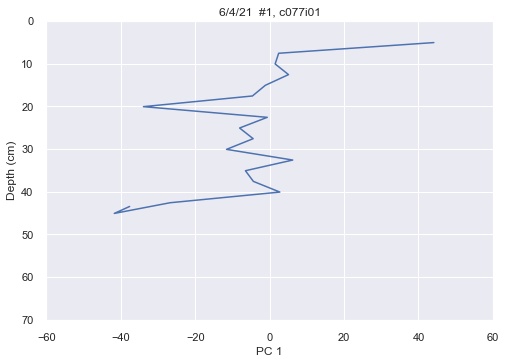

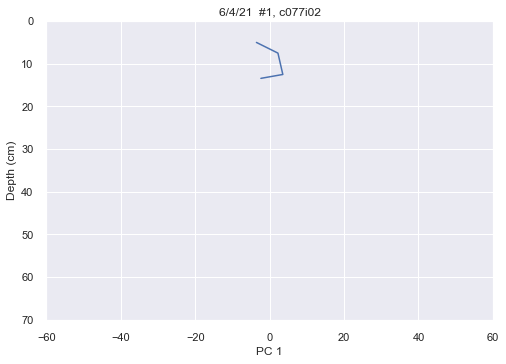

In [52]:
component = 1
for insertion in df_info['i_unique'].unique():
    insertion_df_info = df_info.loc[df_info['i_unique'] == insertion]
    insertion_components = X_pca_df.loc[df_info['i_unique'] == insertion]
    fig, ax = plt.subplots()
    ax.set_title(f"{insertion_df_info.iat[0, -2]}, {insertion}")
    ax.set_ylim(70, 0)
    ax.set_xlim(-60, 60)
    ax.set_ylabel("Depth (cm)")
    ax.set_xlabel(f"PC {component}")
    ax.plot(insertion_components.iloc[:, component - 1], insertion_df_info['depth'])
    plt.show()
    plt.close()

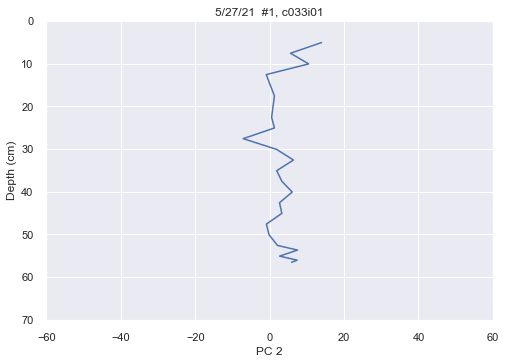

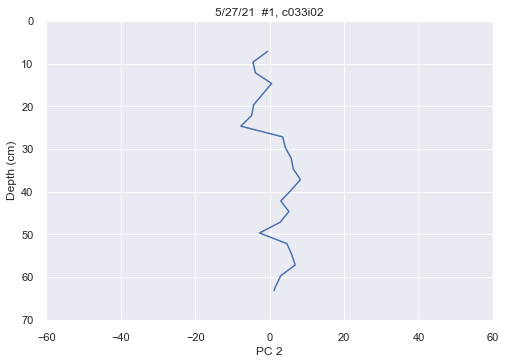

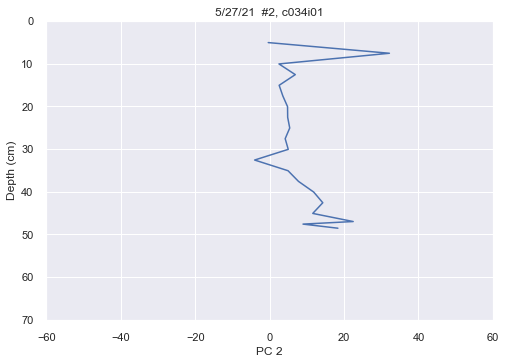

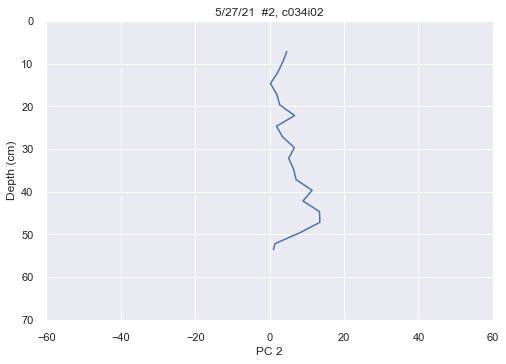

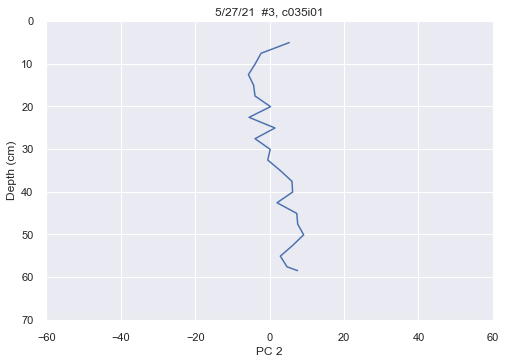

...

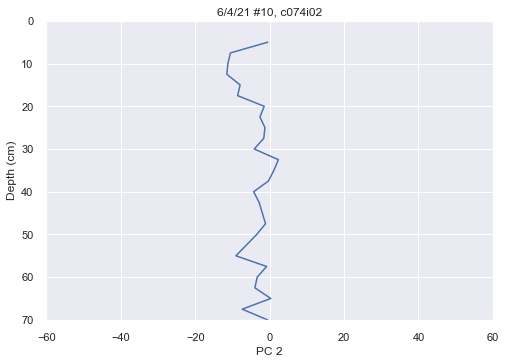

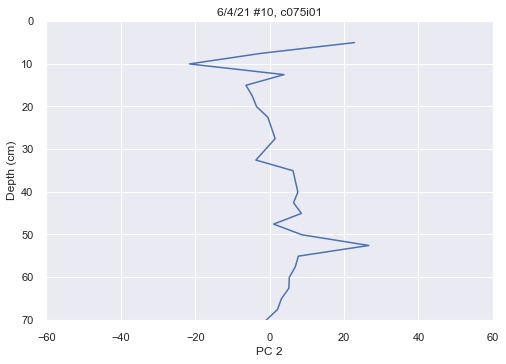

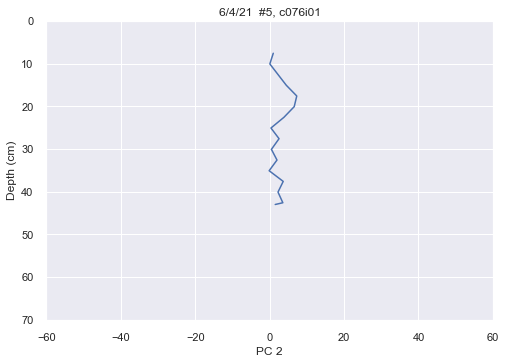

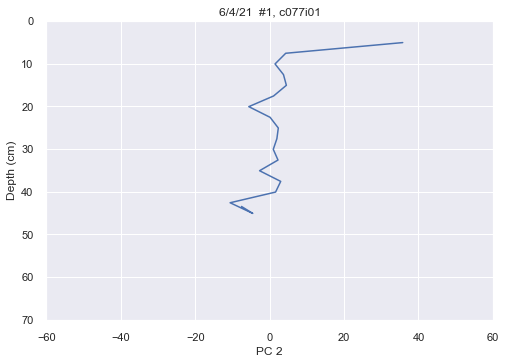

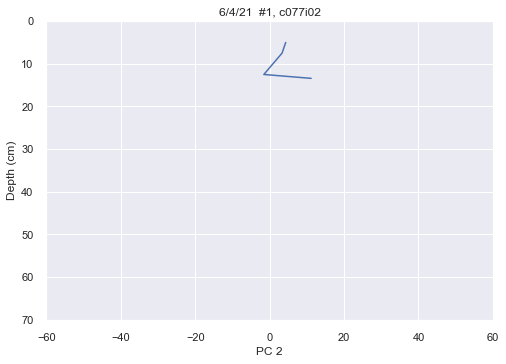

In [53]:
component = 2
for insertion in df_info['i_unique'].unique():
    insertion_df_info = df_info.loc[df_info['i_unique'] == insertion]
    insertion_components = X_pca_df.loc[df_info['i_unique'] == insertion]
    fig, ax = plt.subplots()
    ax.set_title(f"{insertion_df_info.iat[0, -2]}, {insertion}")
    ax.set_ylim(70, 0)
    ax.set_xlim(-60, 60)
    ax.set_ylabel("Depth (cm)")
    ax.set_xlabel(f"PC {component}")
    ax.plot(insertion_components.iloc[:, component - 1], insertion_df_info['depth'])
    plt.show()
    plt.close()

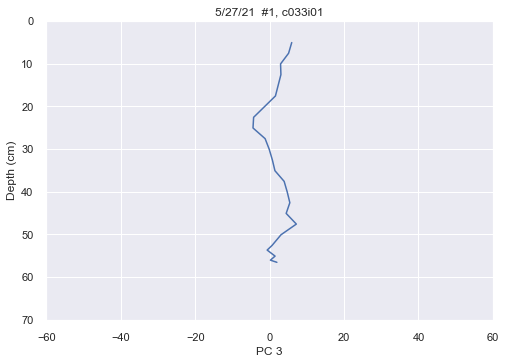

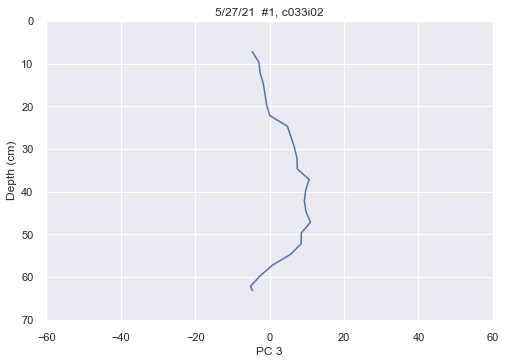

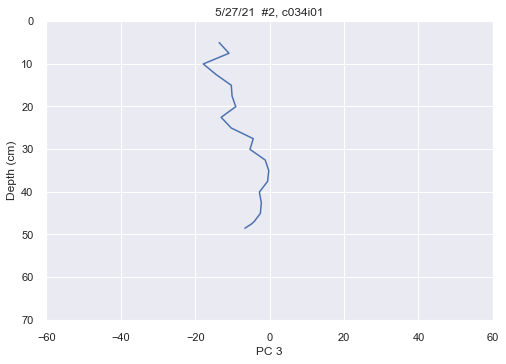

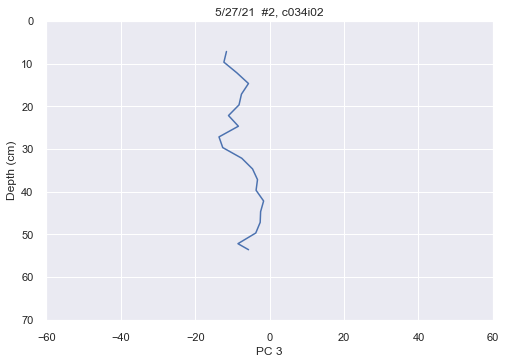

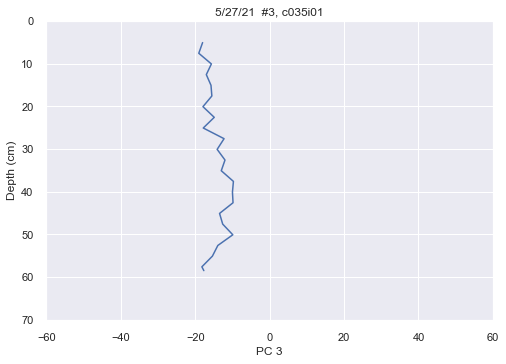

...

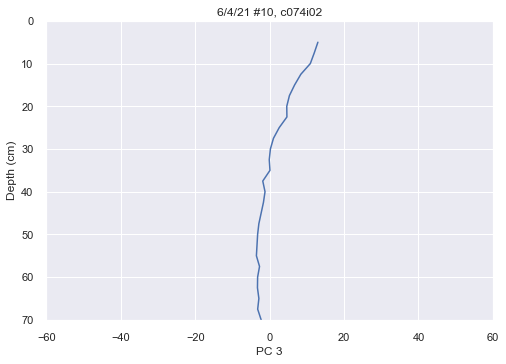

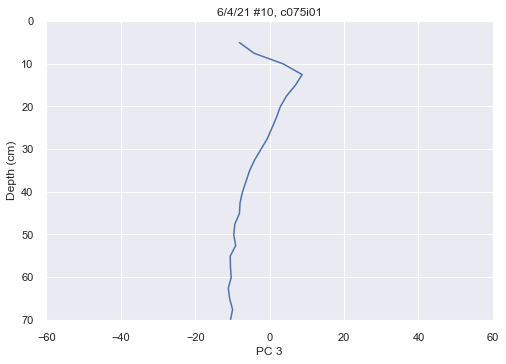

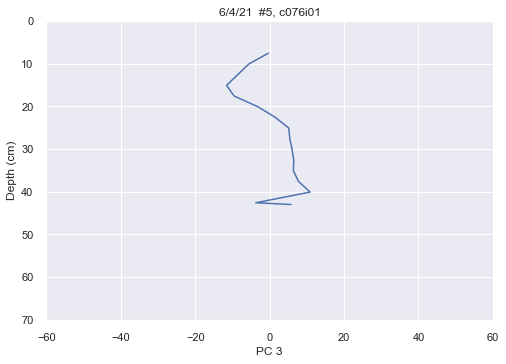

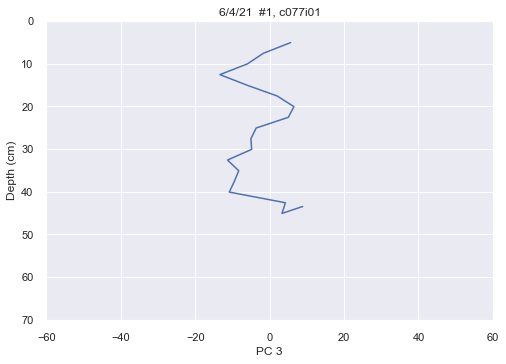

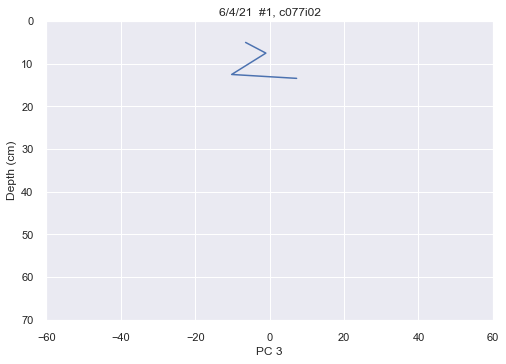

In [54]:
component = 3
for insertion in df_info['i_unique'].unique():
    insertion_df_info = df_info.loc[df_info['i_unique'] == insertion]
    insertion_components = X_pca_df.loc[df_info['i_unique'] == insertion]
    fig, ax = plt.subplots()
    ax.set_title(f"{insertion_df_info.iat[0, -2]}, {insertion}")
    ax.set_ylim(70, 0)
    ax.set_xlim(-60, 60)
    ax.set_ylabel("Depth (cm)")
    ax.set_xlabel(f"PC {component}")
    ax.plot(insertion_components.iloc[:, component - 1], insertion_df_info['depth'])
    plt.show()
    plt.close()

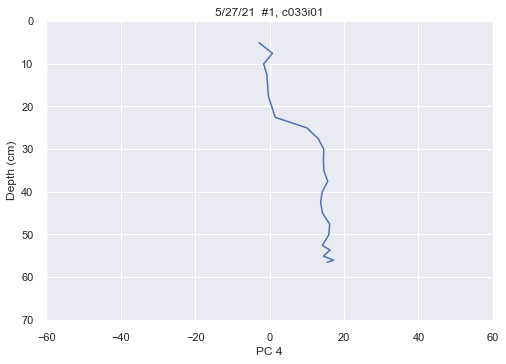

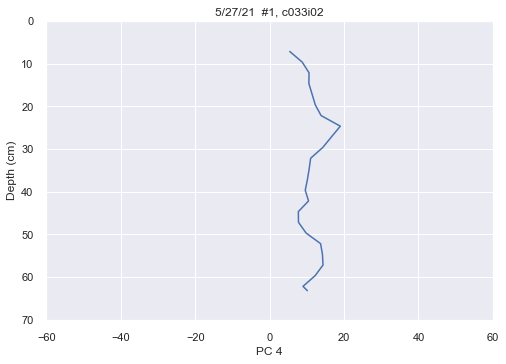

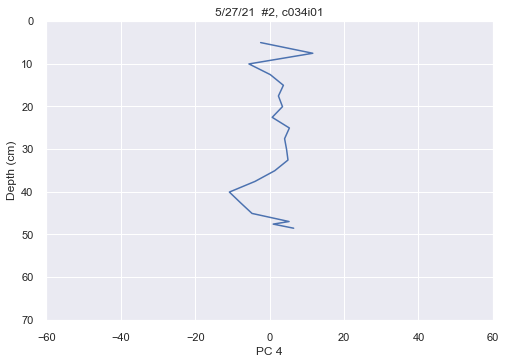

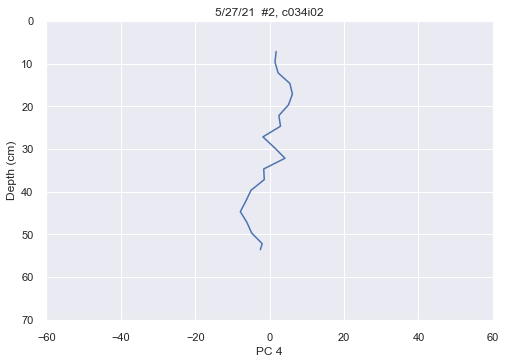

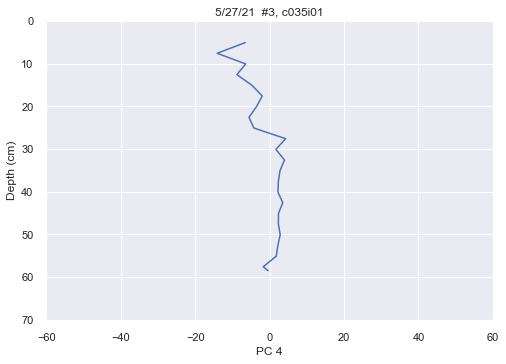

...

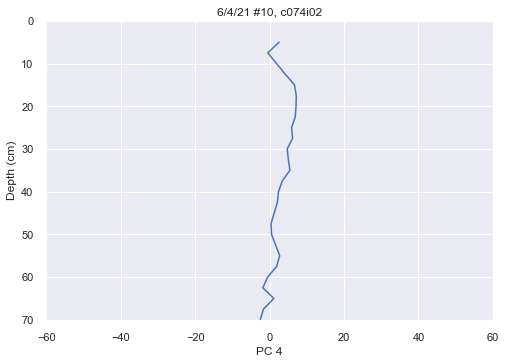

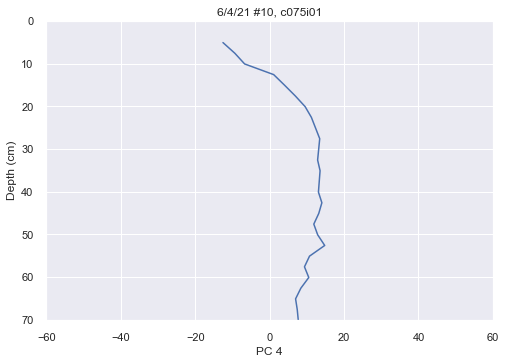

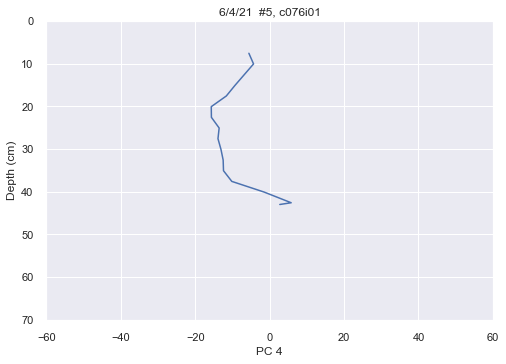

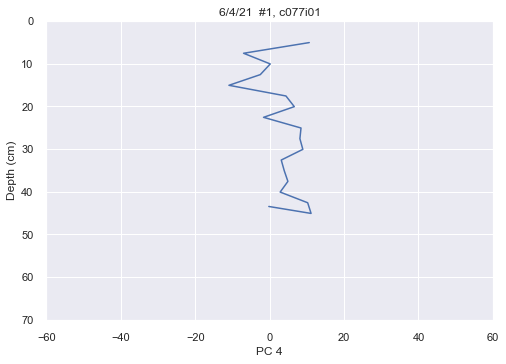

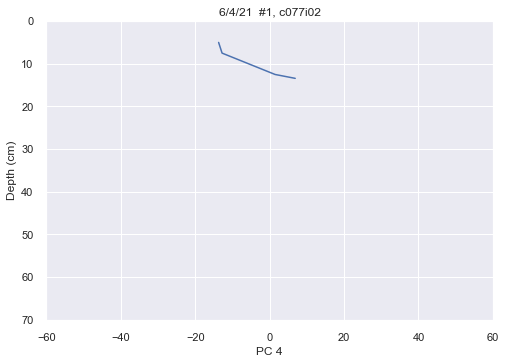

In [55]:
component = 4
for insertion in df_info['i_unique'].unique():
    insertion_df_info = df_info.loc[df_info['i_unique'] == insertion]
    insertion_components = X_pca_df.loc[df_info['i_unique'] == insertion]
    fig, ax = plt.subplots()
    ax.set_title(f"{insertion_df_info.iat[0, -2]}, {insertion}")
    ax.set_ylim(70, 0)
    ax.set_xlim(-60, 60)
    ax.set_ylabel("Depth (cm)")
    ax.set_xlabel(f"PC {component}")
    ax.plot(insertion_components.iloc[:, component - 1], insertion_df_info['depth'])
    plt.show()
    plt.close()